In [1]:
import os
import segmentation_models_pytorch as smp
import pandas as pd
import numpy as np
import albumentations as A
import matplotlib.pyplot as plt
import cv2
import torch
import torch.nn as nn
import albumentations as A
import pickle
import time
import gc


from models import CustomNet, CustomSegmentationModel # import our models
from dataset import ImagePatchDataset
from utils import *


from torch.cuda.amp import GradScaler, autocast
from PIL import Image
from albumentations.pytorch import ToTensorV2
from kaggle.api.kaggle_api_extended import KaggleApi
from torch.utils.data import Dataset
from tqdm import tqdm
from torchvision import transforms as T
from torch.utils.data import DataLoader
from sklearn.model_selection import train_test_split


import torch
from torch.nn import functional as F
from torch.utils.data import Dataset
import cv2
import os
import numpy as np
import albumentations as A
from albumentations.pytorch import ToTensorV2

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

----
# <center> Dataset preparation

In [2]:
train_transform = A.Compose([
    A.RandomRotate90(p=0.5),
    A.Flip(p=0.5),
    A.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=45, p=0.5),
    A.OneOf([
        A.GaussNoise(var_limit=(10.0, 50.0)),
        A.GaussianBlur(blur_limit=(3, 7)),
        A.MotionBlur(blur_limit=(3, 7)),
    ], p=0.5),
    A.OneOf([
        A.RandomBrightnessContrast(brightness_limit=0.2, contrast_limit=0.2),
        A.RandomGamma(),
        A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20),
    ], p=0.5),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), max_pixel_value=255.0),
    A.Resize(256, 256),
    ToTensorV2(),
])

valtest_transform = A.Compose([
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
    A.Resize(256, 256),
    ToTensorV2(),
])

In [3]:
path_img_train = './dataset/train/train-org-img'
path_mask_train = './dataset/train/train-label-img'

path_img_test = './dataset/test/test-org-img'
path_mask_test = './dataset/test/test-label-img'

path_img_val = './dataset/val/val-org-img'
path_mask_val = './dataset/val/val-label-img'

name = []
for filename in os.listdir(path_img_train):
    if os.path.isfile(os.path.join(path_img_train, filename)):
        name.append(os.path.splitext(filename)[0])
train_df = pd.DataFrame({'name': name}, index=np.arange(0, len(name)))

name = []
for filename in os.listdir(path_img_val):
    if os.path.isfile(os.path.join(path_img_val, filename)):
        name.append(os.path.splitext(filename)[0])
val_df = pd.DataFrame({'name': name}, index=np.arange(0, len(name)))

name = []
for filename in os.listdir(path_img_test):
    if os.path.isfile(os.path.join(path_img_test, filename)):
        name.append(os.path.splitext(filename)[0])
test_df = pd.DataFrame({'name': name}, index=np.arange(0, len(name)))

train_df

,name
0,6651
1,7896
2,6748
3,7410
4,6456
...,...
1440,7330
1441,8286
1442,8403
1443,8527


In [4]:
classes = pd.read_excel('dataset/ColorPalette-Values.xlsx', usecols='G:H', skiprows=8)
classes.columns = ['name', 'color']
classes[['R', 'G', 'B']] = classes['color'].str.split(expand=True)
classes['R'] = classes['R'].str.extract(r'(\d+)')
classes['G'] = classes['G'].str.extract(r'(\d+)')
classes['B'] = classes['B'].str.extract(r'(\d+)')
# convert the columns to numeric
classes['R'] = pd.to_numeric(classes['R'])
classes['G'] = pd.to_numeric(classes['G'])
classes['B'] = pd.to_numeric(classes['B'])

# remove color column
classes.drop('color', axis=1, inplace=True)

num_classes = len(classes)
classes

,name,R,G,B
0,background,0,0,0
1,building-flooded,255,0,0
2,building-non-flooded,180,120,120
3,road-flooded,160,150,20
4,road-non-flooded,140,140,140
5,water,61,230,250
6,tree,0,82,255
7,vehicle,255,0,245
8,pool,255,235,0
9,grass,4,250,7


In [5]:
train_dataset = ImagePatchDataset(
    df=train_df,
    img_dir=path_img_train,
    mask_dir=path_mask_train,
    patch_size=(750, 750),
    overlap=0,
    transform=train_transform,
    use_torch=False,
    stitch_levels=2
)

test_dataset = ImagePatchDataset(
    df=test_df,
    img_dir=path_img_test,
    mask_dir=path_mask_test,
    patch_size=(750, 750),
    overlap=0,
    transform=valtest_transform,
    use_torch=False,
)

val_dataset = ImagePatchDataset(
    df=val_df,
    img_dir=path_img_val,
    mask_dir=path_mask_val,
    patch_size=(750, 750),
    overlap=0,
    transform=valtest_transform,
    use_torch=False,
)

Sample 1:
Original image shape: (3000, 4000, 3)
Image patches shape: torch.Size([32, 3, 256, 256])
Mask patches shape: torch.Size([32, 256, 256])
Sample 2:
Original image shape: (3000, 4000, 3)
Image patches shape: torch.Size([32, 3, 256, 256])
Mask patches shape: torch.Size([32, 256, 256])


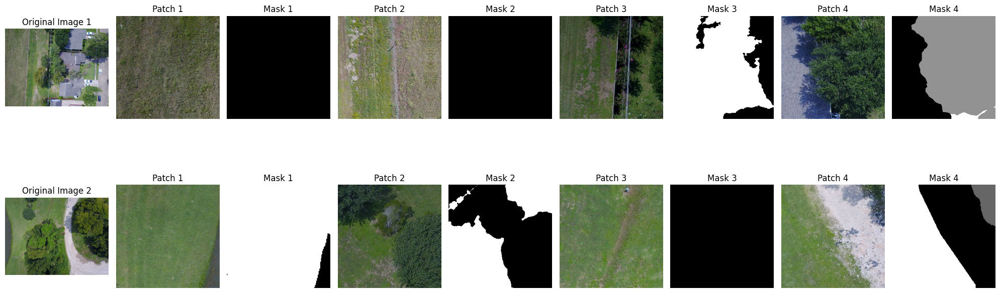

In [6]:
def visualize_normalized_patches(dataset, num_samples=5, patches_per_sample=4):
    fig, axes = plt.subplots(num_samples, patches_per_sample * 2 + 1, figsize=(20, 4 * num_samples))
    
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    
    sample_idx = 0
    while sample_idx < num_samples:
        original_img = dataset.get_original_image(sample_idx)
        if original_img is None:
            sample_idx += 1
            continue
        
        img_patches, mask_patches = dataset[sample_idx]
        if img_patches is None or mask_patches is None:
            sample_idx += 1
            continue
        
        print(f"Sample {sample_idx + 1}:")
        print(f"Original image shape: {original_img.shape}")
        print(f"Image patches shape: {img_patches.shape}")
        print(f"Mask patches shape: {mask_patches.shape}")
        
        axes[sample_idx, 0].imshow(original_img)
        axes[sample_idx, 0].set_title(f'Original Image {sample_idx+1}')
        axes[sample_idx, 0].axis('off')
        
        for patch_idx in range(min(patches_per_sample, len(img_patches))):
            img_patch = img_patches[patch_idx]
            mask_patch = mask_patches[patch_idx]
            
            # convert image patch to numpy array, in (H, W, C) format
            if isinstance(img_patch, torch.Tensor):
                img_patch = img_patch.permute(1, 2, 0).cpu().numpy()
            elif img_patch.shape[0] == 3:
                img_patch = np.transpose(img_patch, (1, 2, 0))
            
            # denormalize the image
            img_patch = img_patch * std + mean
            img_patch = np.clip(img_patch, 0, 1)  # clip values to [0, 1] range
            
            axes[sample_idx, patch_idx * 2 + 1].imshow(img_patch)
            axes[sample_idx, patch_idx * 2 + 1].set_title(f'Patch {patch_idx+1}')
            axes[sample_idx, patch_idx * 2 + 1].axis('off')
            
            if isinstance(mask_patch, torch.Tensor):
                mask_patch = mask_patch.squeeze().cpu().numpy()
            elif mask_patch.ndim > 2:
                mask_patch = mask_patch.squeeze()
            
            axes[sample_idx, patch_idx * 2 + 2].imshow(mask_patch, cmap='gray')
            axes[sample_idx, patch_idx * 2 + 2].set_title(f'Mask {patch_idx+1}')
            axes[sample_idx, patch_idx * 2 + 2].axis('off')
        
        sample_idx += 1
    
    plt.tight_layout()
    plt.show()

visualize_normalized_patches(train_dataset, num_samples=2, patches_per_sample=4)

Total patches: 32
Patch size: 256x256
Number of patches: 4x8
Reconstructed image size: 1034x2066


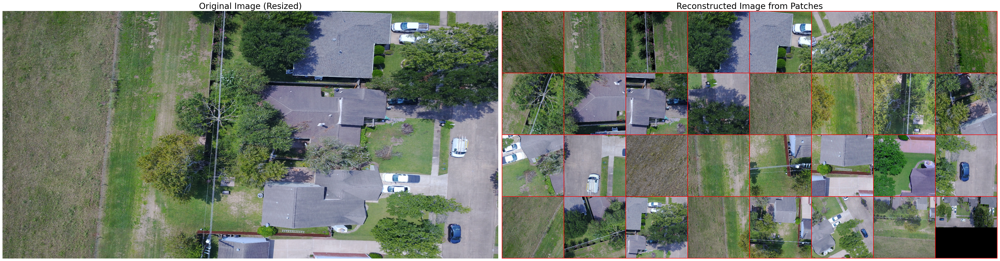

Total patches: 32
Patches per row: 8
Number of rows: 4
Patch size: 256x256
Original image size: 3000x4000
Reconstructed image size: 1034x2066


In [7]:
def visualize_reconstructed_image_patch_based(dataset, idx, border_color=(1, 0, 0), border_size=2):
    img_patches, _ = dataset[idx]
    original_img = dataset.get_original_image(idx)
    original_height, original_width = original_img.shape[:2]

    total_patches = img_patches.shape[0]
    print(f"Total patches: {total_patches}")

    patch_height, patch_width = img_patches.shape[2], img_patches.shape[3]
    print(f"Patch size: {patch_height}x{patch_width}")

    aspect_ratio = original_width / original_height
    num_patches_height = int(np.sqrt(total_patches / aspect_ratio))
    num_patches_width = int(np.ceil(total_patches / num_patches_height))
    
    while num_patches_height * num_patches_width < total_patches:
        num_patches_height += 1

    print(f"Number of patches: {num_patches_height}x{num_patches_width}")

    # calculate the size of the reconstructed image based on the actual patch sizes
    reconstructed_height = num_patches_height * patch_height + (num_patches_height + 1) * border_size
    reconstructed_width = num_patches_width * patch_width + (num_patches_width + 1) * border_size
    print(f"Reconstructed image size: {reconstructed_height}x{reconstructed_width}")

    # array with the border color to hold the reconstructed image
    reconstructed_img = np.full((reconstructed_height, reconstructed_width, 3), border_color, dtype=np.float32)

    # normalization parameters
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])

    for patch_idx in range(total_patches):
        # calculate row and column index
        row = patch_idx // num_patches_width
        col = patch_idx % num_patches_width

        y = row * (patch_height + border_size) + border_size
        x = col * (patch_width + border_size) + border_size

        img_patch = img_patches[patch_idx]

        if isinstance(img_patch, torch.Tensor):
            img_patch = img_patch.permute(1, 2, 0).cpu().numpy()

        # denormalize the image patch
        img_patch = (img_patch * std + mean)
        img_patch = np.clip(img_patch, 0, 1)  # clip values to [0, 1] range

        # assign the image patch to the reconstructed image
        reconstructed_img[y:y+patch_height, x:x+patch_width, :] = img_patch

    resized_original_img = cv2.resize(original_img, (reconstructed_width, reconstructed_height))
    resized_original_img = resized_original_img.astype(np.float32) / 255.0  # normalize to [0, 1]


    fig, axs = plt.subplots(1, 2, figsize=(40, 20))
    
    axs[0].imshow(resized_original_img)
    axs[0].set_title("Original Image (Resized)", fontsize=24)
    axs[0].axis('off')

    axs[1].imshow(reconstructed_img)
    axs[1].set_title("Reconstructed Image from Patches", fontsize=24)
    axs[1].axis('off')

    plt.tight_layout()
    plt.show()

    print(f"Total patches: {total_patches}")
    print(f"Patches per row: {num_patches_width}")
    print(f"Number of rows: {num_patches_height}")
    print(f"Patch size: {patch_height}x{patch_width}")
    print(f"Original image size: {original_height}x{original_width}")
    print(f"Reconstructed image size: {reconstructed_height}x{reconstructed_width}")

visualize_reconstructed_image_patch_based(train_dataset, 0, border_color=(1, 0, 0), border_size=2)

/tmp/ipykernel_170670/975802532.py:42: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # make room for the legend


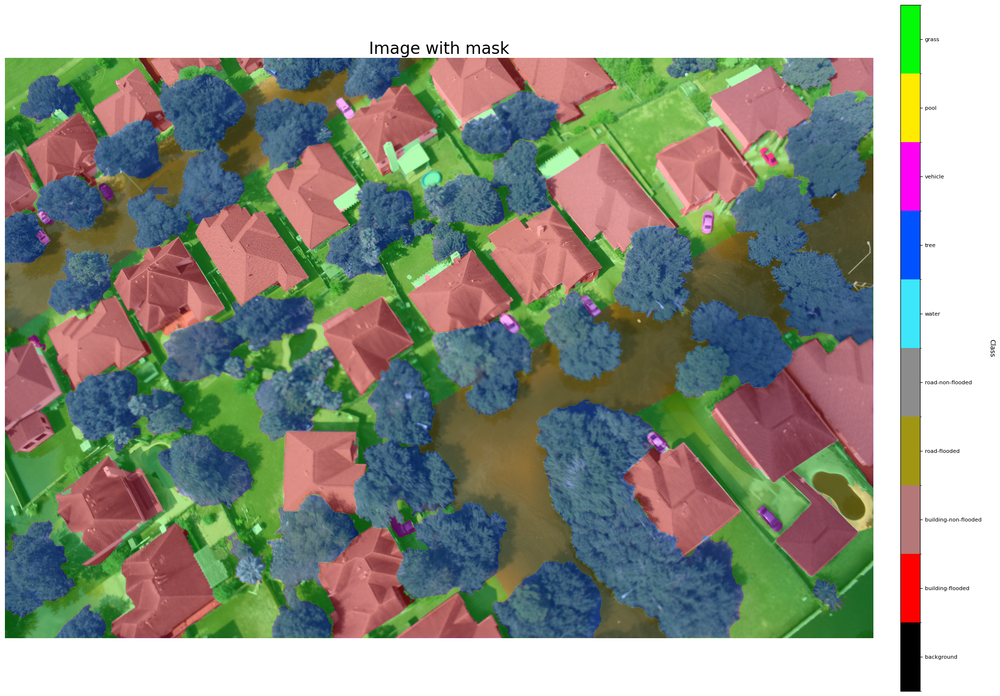

In [8]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
from matplotlib.cm import ScalarMappable
from matplotlib.colors import BoundaryNorm
from PIL import Image
import os

def visualize_single_image_with_mask(df, path_img, path_mask, classes, rnd=None):
    if rnd is None:
        rnd = np.random.randint(0, len(df))
    
    img = Image.open(os.path.join(path_img, df['name'][rnd] + '.jpg'))
    mask = Image.open(os.path.join(path_mask, df['name'][rnd] + '_lab.png'))
    
    mask_array = np.array(mask)

    colors = classes[['R', 'G', 'B']].values / 255.0
    cmap = mcolors.ListedColormap(colors)

    fig, ax = plt.subplots(figsize=(20, 20))

    ax.imshow(img)

    masked = ax.imshow(mask_array, cmap=cmap, alpha=0.3, vmin=0, vmax=len(classes)-1)
    
    ax.set_title(f'Image with mask', fontsize=24)
    ax.axis('off')

    # boundaries for the colorbar
    bounds = np.arange(len(classes) + 1)
    norm = BoundaryNorm(bounds, cmap.N)

    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    cbar = fig.colorbar(ScalarMappable(cmap=cmap, norm=norm), cax=cbar_ax, 
                        spacing='proportional', ticks=bounds[:-1] + 0.5)
    
    cbar.set_ticklabels(classes['name'])
    cbar.ax.tick_params(labelsize=8)
    cbar.set_label('Class', rotation=270, labelpad=20)

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # make room for the legend
    plt.show()


visualize_single_image_with_mask(train_df, path_img_train, path_mask_train, classes)

----
# <center> Training

In [9]:
def iou_score(outputs, targets):
    smooth = 1e-6
    outputs = outputs.argmax(1)
    intersection = (outputs & targets).float().sum((1, 2))
    union = (outputs | targets).float().sum((1, 2))
    iou = (intersection + smooth) / (union + smooth)
    return iou.mean()

def dice_score(outputs, targets):
    smooth = 1e-6
    outputs = outputs.argmax(1)
    intersection = (outputs & targets).float().sum((1, 2))
    dice = (2. * intersection + smooth) / (outputs.float().sum((1, 2)) + targets.float().sum((1, 2)) + smooth)
    return dice.mean()

In [10]:
class AccumulateBN:
    def __init__(self, accumulation_steps):
        self.accumulation_steps = accumulation_steps
        self.accumulated_steps = 0
        self.accumulated_mean = None
        self.accumulated_var = None

    def update(self, module):
        if self.accumulation_steps == 1:
            return  # No accumulation needed, use PyTorch's default behavior by skipping this function

        if self.accumulated_mean is None:
            self.accumulated_mean = module.running_mean.clone()
            self.accumulated_var = module.running_var.clone()
        else:
            self.accumulated_mean += module.running_mean
            self.accumulated_var += module.running_var
        self.accumulated_steps += 1

        if self.accumulated_steps == self.accumulation_steps:
            module.running_mean.data.copy_(self.accumulated_mean / self.accumulation_steps)
            module.running_var.data.copy_(self.accumulated_var / self.accumulation_steps)
            self.accumulated_steps = 0
            self.accumulated_mean = None
            self.accumulated_var = None

In [11]:
def train_model(epochs, model, train_loader, val_loader, criterion, optimizer, scheduler, device, experiment_name, accumulation_steps=1, use_amp=False, clip_grad_norm=None):
    model_path = f'models/{experiment_name}_last.pth'
    history_path = f'models/pickles/{experiment_name}_history.pkl'
    checkpoint_path = f'models/{experiment_name}_checkpoint.pth'
    
    # Initialize GradScaler for mixed precision training
    scaler = GradScaler(enabled=use_amp)
    
    # --------------------------------------------------------------RESUME TRAINING--------------------------------------------------------------
    start_epoch = 0
    if os.path.exists(model_path) and os.path.exists(history_path) and os.path.exists(checkpoint_path):
        print(f"Resuming training for experiment: {experiment_name}")
        checkpoint = torch.load(checkpoint_path, map_location=device)
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        if scheduler and 'scheduler_state_dict' in checkpoint:
            scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
        if use_amp and 'scaler_state_dict' in checkpoint:
            scaler.load_state_dict(checkpoint['scaler_state_dict'])
        start_epoch = checkpoint['epoch'] + 1
        history = safe_pickle_load(history_path)
        best_val_loss = checkpoint['best_val_loss']
        print(f"Resuming from epoch {start_epoch}")
    else:
        print(f"Starting new training for experiment: {experiment_name}")
        history = {'train_loss': [], 'val_loss': [], 'train_acc': [], 'val_acc': [], 'train_iou': [], 'val_iou': [], 'train_dice': [], 'val_dice': []}
        best_val_loss = float('inf')

    patience = 14
    patience_counter = 0

    model.to(device)
    start_time = time.time()

    # --------------------------------------------------------------TRAINING LOOP--------------------------------------------------------------

    for epoch in range(start_epoch, epochs):
        print(f"Epoch {epoch+1}/{epochs}")
        
        model.train()
        train_loss = 0
        train_correct = 0
        train_total = 0
        train_iou = 0
        train_dice = 0
        
        # Initialize GradScaler for mixed precision training
        scaler = GradScaler(enabled=use_amp)
        
        # Initialize AccumulateBN for each BatchNorm layer
        bn_accumulators = {name: AccumulateBN(accumulation_steps) 
                        for name, module in model.named_modules() 
                        if isinstance(module, torch.nn.BatchNorm2d)}

        optimizer.zero_grad(set_to_none=True)
        for i, (image_patches, mask_patches) in enumerate(tqdm(train_loader, desc="Training")):
            # Handle both 4D and 5D tensors
            if image_patches.dim() == 5:
                b, n, c, h, w = image_patches.shape
                image_patches = image_patches.view(-1, c, h, w)
            elif image_patches.dim() == 4:
                b, c, h, w = image_patches.shape
            else:
                raise ValueError(f"Unexpected image_patches shape: {image_patches.shape}")

            image_patches = image_patches.to(device, non_blocking=True)
            
            if mask_patches.dim() == 4:
                mask_patches = mask_patches.view(-1, h, w)
            elif mask_patches.dim() != 3:
                raise ValueError(f"Unexpected mask_patches shape: {mask_patches.shape}")

            mask_patches = mask_patches.to(device, non_blocking=True)
            
            # Forward pass
            with autocast(enabled=use_amp):
                outputs = model(image_patches)
                loss = criterion(outputs, mask_patches)
                loss = loss / accumulation_steps

            # Backward pass
            scaler.scale(loss).backward()

            # Update BN statistics
            for name, module in model.named_modules():
                if isinstance(module, torch.nn.BatchNorm2d):
                    bn_accumulators[name].update(module)


            if (i + 1) % accumulation_steps == 0 or (i + 1) == len(train_loader):
                # Gradient clipping
                if clip_grad_norm is not None:
                    scaler.unscale_(optimizer)
                    torch.nn.utils.clip_grad_norm_(model.parameters(), clip_grad_norm)
                
                # Optimizer step
                scaler.step(optimizer)
                scaler.update()
                optimizer.zero_grad(set_to_none=True)

            # Calculate metrics (using non-scaled loss)
            with torch.no_grad():
                train_loss += loss.item() * accumulation_steps
                predicted = outputs.argmax(1)
                train_correct += (predicted == mask_patches).sum().item()
                train_total += mask_patches.numel()
                train_iou += iou_score(outputs, mask_patches)
                train_dice += dice_score(outputs, mask_patches)

        train_loss /= len(train_loader)
        train_acc = train_correct / train_total
        train_iou /= len(train_loader)
        train_dice /= len(train_loader)

        # Validation phase
        model.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0
        val_iou = 0
        val_dice = 0

        # --------------------------------------------------------------VALIDATION LOOP--------------------------------------------------------------

        with torch.no_grad():
            for image_patches, mask_patches in tqdm(val_loader, desc="Validation"):
                # Handle both 4D and 5D tensors
                if image_patches.dim() == 5:
                    b, n, c, h, w = image_patches.shape
                    image_patches = image_patches.view(-1, c, h, w)
                elif image_patches.dim() == 4:
                    b, c, h, w = image_patches.shape
                else:
                    raise ValueError(f"Unexpected image_patches shape: {image_patches.shape}")

                image_patches = image_patches.to(device, non_blocking=True)
                
                if mask_patches.dim() == 4:
                    mask_patches = mask_patches.view(-1, h, w)
                elif mask_patches.dim() != 3:
                    raise ValueError(f"Unexpected mask_patches shape: {mask_patches.shape}")

                mask_patches = mask_patches.to(device, non_blocking=True)
                
                with autocast(enabled=use_amp):
                    outputs = model(image_patches)
                    loss = criterion(outputs, mask_patches)

                val_loss += loss.item()
                predicted = outputs.argmax(1)
                val_correct += (predicted == mask_patches).sum().item()
                val_total += mask_patches.numel()
                val_iou += iou_score(outputs, mask_patches)
                val_dice += dice_score(outputs, mask_patches)

        val_loss /= len(val_loader)
        val_acc = val_correct / val_total
        val_iou /= len(val_loader)
        val_dice /= len(val_loader)

        # --------------------------------------------------------------PRINTING AND SAVING--------------------------------------------------------------

        history['train_loss'].append(train_loss)
        history['val_loss'].append(val_loss)
        history['train_acc'].append(train_acc)
        history['val_acc'].append(val_acc)
        history['train_iou'].append(train_iou)
        history['val_iou'].append(val_iou)
        history['train_dice'].append(train_dice)
        history['val_dice'].append(val_dice)

        print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, Train IoU: {train_iou:.4f}, Train Dice: {train_dice:.4f}")
        print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}, Val IoU: {val_iou:.4f}, Val Dice: {val_dice:.4f}")

        if scheduler:
            scheduler.step()

        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), f'models/{experiment_name}_best.pth')
            print("Saved best model")
            patience_counter = 0
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping triggered after {epoch + 1} epochs")
                break
        
        checkpoint = {
            'epoch': epoch,
            'model_state_dict': model.state_dict(),
            'optimizer_state_dict': optimizer.state_dict(),
            'scheduler_state_dict': scheduler.state_dict() if scheduler else None,
            'scaler_state_dict': scaler.state_dict() if use_amp else None,
            'best_val_loss': best_val_loss,
        }
        torch.save(checkpoint, checkpoint_path)
        torch.save(model.state_dict(), model_path)
        safe_pickle_dump(history, history_path)

    total_time = time.time() - start_time
    print(f'Training completed in {total_time / 60:.2f} minutes')

    return history

In [49]:
# this is a working bench, this is dirty and poorly written, but it's fast and it works


num_epochs = 100

# uncomment the model you want to use

model = smp.create_model(arch = 'DeepLabV3Plus',
                 encoder_name = 'resnet34',
                 encoder_weights = 'imagenet',
                 classes = num_classes,
                 in_channels = 3)


#model = smp.Unet('efficientnet-b3', classes=num_classes, in_channels=3, encoder_weights='imagenet')

# model = smp.create_model(arch = 'DeepLabV3Plus',
#                  encoder_name = 'efficientnet-b5',
#                  encoder_weights = 'imagenet',
#                  classes = num_classes,
#                  in_channels = 3)

#model = CustomNet(num_classes=len(classes))
#model = CustomSegmentationModel(num_classes=len(classes))
#model = SimplifiedImprovedModel(num_classes=len(classes))

train_loader = DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=8, prefetch_factor=2, pin_memory=True)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=8, prefetch_factor=2, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=8, prefetch_factor=2, pin_memory=True)


model.to(device)
criterion = nn.CrossEntropyLoss()
#criterion = FocalLoss(alpha=0.25, gamma=2)
optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, fused=True)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, num_epochs)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=10, T_mult=2)


# you can change the experiment name to load a different model

#experiment_name = 'CustomSegmentationModel_lightweight'
#experiment_name = 'DeepLabv3Plus_efficientnet-b5'
experiment_name = 'DeepLabV3Plus_resnet34_750'
#experiment_name = 'efficientnet-b3'


# this is commented out because we are loading the model and history from the last run for visualization, you can uncomment this to train the model

# history = train_model(
#     epochs=num_epochs,
#     model=model,
#     train_loader=train_loader,
#     val_loader=val_loader,
#     criterion=criterion, 
#     optimizer=optimizer,
#     scheduler=scheduler,
#     device=device,
#     experiment_name=experiment_name,
#     accumulation_steps=2
# )

# load model and history

model.load_state_dict(torch.load(f'models/{experiment_name}_best.pth'))
history = safe_pickle_load(f'models/pickles/{experiment_name}_history.pkl')


----
# <center>Visualization

In [50]:
def test_model(model, test_loader, criterion, device, classes_df):
    model.eval()
    test_loss = 0
    test_correct = 0
    test_total = 0
    test_iou = 0
    test_dice = 0
    total_time = 0
    num_images = 0

    original_height, original_width = 3000, 4500
    num_classes = len(classes_df)

    class_intersection = torch.zeros(num_classes, device=device)
    class_union = torch.zeros(num_classes, device=device)

    with torch.no_grad():
        for idx, (image_patches, mask_patches) in enumerate(tqdm(test_loader, desc="Testing")):
            batch_start_time = time.time()
            
            # move entire batch to GPU at once
            image_patches = image_patches.to(device, non_blocking=True)
            mask_patches = mask_patches.to(device, non_blocking=True)
            
            b, n, c, h, w = image_patches.shape
            image_patches = image_patches.view(-1, c, h, w)
            mask_patches = mask_patches.view(-1, h, w)
            
            outputs = model(image_patches)
            loss = criterion(outputs, mask_patches)

            test_loss += loss.item()
            predicted = outputs.argmax(1)
            test_correct += (predicted == mask_patches).sum().item()
            test_total += mask_patches.numel()
            test_iou += iou_score(outputs, mask_patches)
            test_dice += dice_score(outputs, mask_patches)

            # calculate per-class IoU
            for class_idx in range(num_classes):
                pred_mask = (predicted == class_idx)
                true_mask = (mask_patches == class_idx)
                intersection = (pred_mask & true_mask).sum()
                union = (pred_mask | true_mask).sum()
                class_intersection[class_idx] += intersection
                class_union[class_idx] += union

            total_patches = image_patches.shape[0]
            patch_height, patch_width = h, w

            aspect_ratio = original_width / original_height
            num_patches_height = max(1, int((total_patches / aspect_ratio) ** 0.5))
            num_patches_width = max(1, int((total_patches * aspect_ratio) ** 0.5))
            
            while num_patches_height * num_patches_width < total_patches:
                if num_patches_height <= num_patches_width:
                    num_patches_height += 1
                else:
                    num_patches_width += 1

            reconstructed_pred_mask = fast_reconstruct_from_patches(predicted, num_patches_height, num_patches_width, patch_height, patch_width)
            
            # crop on GPU
            reconstructed_pred_mask = reconstructed_pred_mask[:original_height, :original_width]

            batch_end_time = time.time()
            batch_time = batch_end_time - batch_start_time
            total_time += batch_time
            num_images += 1

    test_loss /= len(test_loader)
    test_acc = test_correct / test_total
    test_iou /= len(test_loader)
    test_dice /= len(test_loader)
    avg_time_per_image = total_time / num_images
    fps = 1 / avg_time_per_image 

    # finish calculating per-class IoU
    class_iou = class_intersection / (class_union + 1e-8)  # small epsilon to avoid division by zero
    class_iou = class_iou.cpu().numpy()

    print(f"Test Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}, Test IoU: {test_iou:.4f}, Test Dice: {test_dice:.4f}")
    print(f"Average time per image (including reconstruction): {avg_time_per_image:.4f} seconds")
    print(f"Frames per second (FPS): {fps:.2f}")
    print("Per-class IoU:")
    for (_, row), iou in zip(classes_df.iterrows(), class_iou):
        print(f"{row['name']}: {iou:.4f}")

    return {
        'test_loss': test_loss,
        'test_acc': test_acc,
        'test_iou': test_iou,
        'test_dice': test_dice,
        'avg_time_per_image': avg_time_per_image,
        'fps': fps,
        'class_iou': {row['name']: iou for (_, row), iou in zip(classes_df.iterrows(), class_iou.tolist())}
    }

test_dataset = ImagePatchDataset(
    df=test_df,
    img_dir=path_img_test,
    mask_dir=path_mask_test,
    patch_size=(3000, 4500),
    overlap=0,
    transform=valtest_transform,
    use_torch=True,
)


test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=8, prefetch_factor=2, pin_memory=True)

test_results = test_model(model, test_loader, criterion, device, classes)

Testing:  34%|███▍      | 153/450 [00:14<00:26, 11.35it/s]

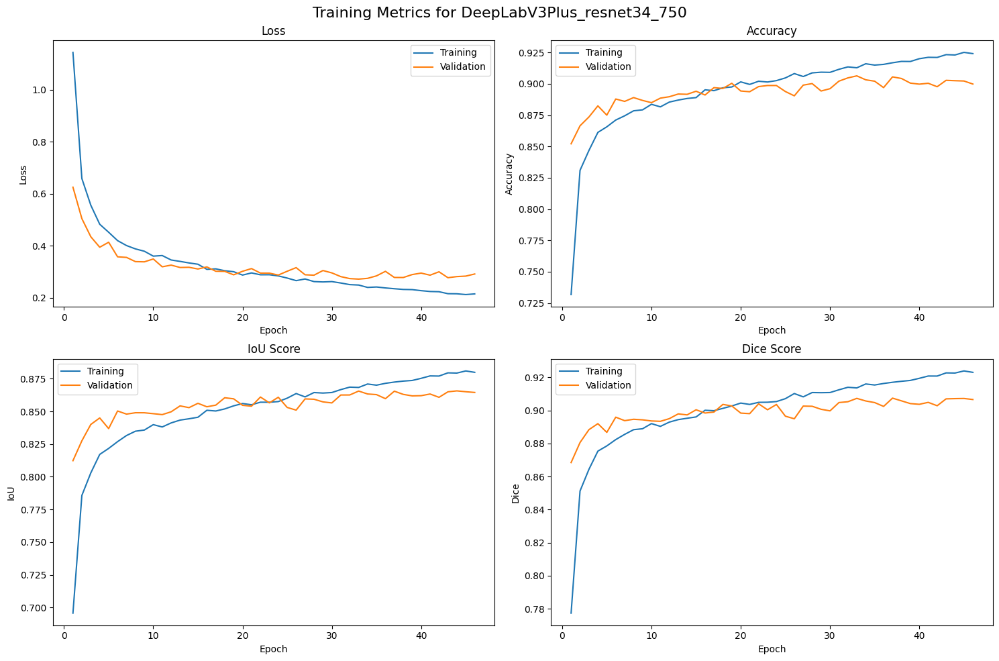

In [18]:
def plot_metrics_from_pickle(pickle_path, experiment_name):
    
    with open(pickle_path, 'rb') as f:
        history = pickle.load(f)

    history_numpy = {k: convert_to_numpy(v) for k, v in history.items()}

    fig, axs = plt.subplots(2, 2, figsize=(15, 10))

    metrics = [
        ('loss', 'Loss', 'Loss'),
        ('acc', 'Accuracy', 'Accuracy'),
        ('iou', 'IoU Score', 'IoU'),
        ('dice', 'Dice Score', 'Dice')
    ]

    for (i, j), (metric, title, ylabel) in zip([(0,0), (0,1), (1,0), (1,1)], metrics):
        train_key = f'train_{metric}'
        val_key = f'val_{metric}'
        
        if train_key in history_numpy and len(history_numpy[train_key]) > 0:
            train_data = history_numpy[train_key]
            axs[i, j].plot(range(1, len(train_data)+1), train_data, label='Training')
        
        if val_key in history_numpy and len(history_numpy[val_key]) > 0:
            val_data = history_numpy[val_key]
            axs[i, j].plot(range(1, len(val_data)+1), val_data, label='Validation')
        
        axs[i, j].set_title(title)
        axs[i, j].set_xlabel('Epoch')
        axs[i, j].set_ylabel(ylabel)
        axs[i, j].legend()

    plt.tight_layout()
    plt.suptitle(f'Training Metrics for {experiment_name}', fontsize=16)
    plt.subplots_adjust(top=0.93)
    plt.show()
    plt.close()

# Usage
plot_metrics_from_pickle(f'models/pickles/{experiment_name}_history.pkl', experiment_name)

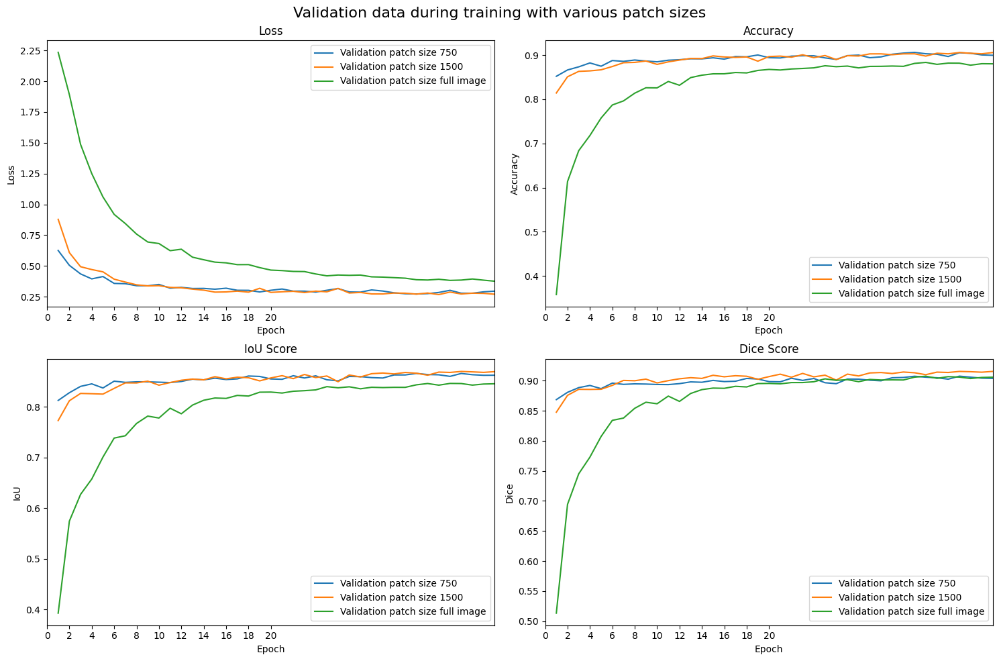

In [19]:

pickle_path_1 = f'models/pickles/DeepLabV3Plus_resnet34_750_history.pkl'
pickle_path_2 = f'models/pickles/DeepLabV3Plus_resnet34_history.pkl'
pickle_path_3 = f'models/pickles/DeepLabV3Plus_resnet34_native_history.pkl'

with open(pickle_path_1, 'rb') as f:
    history_1 = pickle.load(f)

with open(pickle_path_2, 'rb') as f:
    history_2 = pickle.load(f)

with open(pickle_path_3, 'rb') as f:
    history_3 = pickle.load(f)

history_numpy_1 = {k: convert_to_numpy(v) for k, v in history_1.items()}
history_numpy_2 = {k: convert_to_numpy(v) for k, v in history_2.items()}
history_numpy_3 = {k: convert_to_numpy(v) for k, v in history_3.items()}

fig, axs = plt.subplots(2, 2, figsize=(15, 10))

metrics = [
    ('loss', 'Loss', 'Loss'),
    ('acc', 'Accuracy', 'Accuracy'),
    ('iou', 'IoU Score', 'IoU'),
    ('dice', 'Dice Score', 'Dice')
]

for (i, j), (metric, title, ylabel) in zip([(0,0), (0,1), (1,0), (1,1)], metrics):
    train_key = f'train_{metric}'
    val_key = f'val_{metric}'
    
    
    if val_key in history_numpy_1 and len(history_numpy_1[val_key]) > 0:
        val_data = history_numpy_1[val_key]
        axs[i, j].plot(range(1, len(val_data)+1), val_data, label='Validation patch size 750')
    
    if val_key in history_numpy_2 and len(history_numpy_2[val_key]) > 0:
        val_data = history_numpy_2[val_key]
        axs[i, j].plot(range(1, len(val_data)+1), val_data, label='Validation patch size 1500')
        
    if val_key in history_numpy_3 and len(history_numpy_3[val_key]) > 0:
        val_data = history_numpy_3[val_key]
        axs[i, j].plot(range(1, len(val_data)+1), val_data, label='Validation patch size full image')
        
    
    
    axs[i, j].set_title(title)
    axs[i, j].set_xlabel('Epoch')
    axs[i, j].set_xlim(0, 40)
    axs[i, j].set_xticks(range(0, 21, 2))
    axs[i, j].set_ylabel(ylabel)
    axs[i, j].legend()

plt.tight_layout()
plt.suptitle(f'Validation data during training with various patch sizes', fontsize=16)
plt.subplots_adjust(top=0.93)
plt.show()
plt.close()


# print("Max values for each metric:")
# for metric in ['train_loss', 'val_loss', 'train_acc', 'val_acc', 'train_iou', 'val_iou', 'train_dice', 'val_dice']:
#     max_val = max(history_1[metric])
#     print(f"h1 {metric}: {max_val:.4f}")
#     max_val = max(history_2[metric][:20])
#     print(f"h2 {metric}: {max_val:.4f}")
#     max_val = max(history_3[metric])
#     print(f"h3 {metric}: {max_val:.4f}")

Original image shape: (3000, 4000, 3)
Image patches shape: torch.Size([6, 3, 256, 256])
True mask patches shape: torch.Size([6, 256, 256])
Number of patches: 2x3
Predicted mask patches shape: torch.Size([6, 256, 256])


/tmp/ipykernel_170670/3681979665.py:109: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1], pad=0.5, w_pad=0.5, h_pad=0.5) # make room for the legend


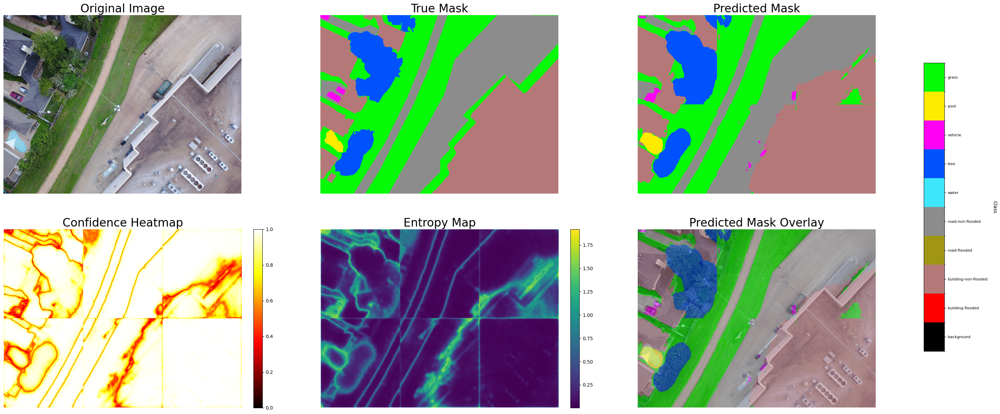

Number of classes: 10
Unique values in true mask: [2 4 6 7 8 9]
Unique values in predicted mask: [2 4 6 7 8 9]


In [41]:
def visualize_predictions_with_heatmap(model, dataset, idx, device, classes):
    model.eval()
    img_patches, true_mask_patches = dataset[idx]
    original_img = dataset.get_original_image(idx)
    original_height, original_width = original_img.shape[:2]

    print(f"Original image shape: {original_img.shape}")
    print(f"Image patches shape: {img_patches.shape}")
    print(f"True mask patches shape: {true_mask_patches.shape}")

    total_patches = img_patches.shape[0]
    patch_height, patch_width = img_patches.shape[2], img_patches.shape[3] # don't think I need it but just in case

    aspect_ratio = original_width / original_height
    num_patches_height = max(1, int(np.sqrt(total_patches / aspect_ratio)))
    num_patches_width = max(1, int(np.ceil(total_patches / num_patches_height)))
    
    while num_patches_height * num_patches_width < total_patches:
        if num_patches_height <= num_patches_width:
            num_patches_height += 1
        else:
            num_patches_width += 1

    print(f"Number of patches: {num_patches_height}x{num_patches_width}")

    with torch.no_grad():
        img_patches = img_patches.to(device)
        pred_mask_patches = model(img_patches)
        pred_probs = torch.softmax(pred_mask_patches, dim=1)
        pred_mask_patches = torch.argmax(pred_mask_patches, dim=1)

    print(f"Predicted mask patches shape: {pred_mask_patches.shape}")

    # reconstruct true mask, predicted mask, and probability maps
    
    true_mask_patches = true_mask_patches.to(device)
    reconstructed_true_mask = fast_reconstruct_from_patches(true_mask_patches, num_patches_height, num_patches_width, patch_height, patch_width)
    reconstructed_pred_mask = fast_reconstruct_from_patches(pred_mask_patches, num_patches_height, num_patches_width, patch_height, patch_width)
    
    prob_maps = []
    for i in range(len(classes)):
        prob_map = fast_reconstruct_from_patches(pred_probs[:, i], num_patches_height, num_patches_width, patch_height, patch_width)
        prob_maps.append(prob_map.cpu().numpy())

    reconstructed_true_mask = reconstructed_true_mask.cpu().numpy()
    reconstructed_pred_mask = reconstructed_pred_mask.cpu().numpy()

    # resize masks and probability maps to original image size
    reconstructed_true_mask = cv2.resize(reconstructed_true_mask, (original_width, original_height), interpolation=cv2.INTER_NEAREST)
    reconstructed_pred_mask = cv2.resize(reconstructed_pred_mask, (original_width, original_height), interpolation=cv2.INTER_NEAREST)
    prob_maps = [cv2.resize(prob_map, (original_width, original_height), interpolation=cv2.INTER_LINEAR) for prob_map in prob_maps]

    colors = classes[['R', 'G', 'B']].values / 255.0
    cmap = mcolors.ListedColormap(colors)

    fig, axs = plt.subplots(2, 3, figsize=(30, 12))
    
    axs[0, 0].imshow(original_img)
    axs[0, 0].set_title("Original Image", fontsize=24)
    axs[0, 0].axis('off')

    axs[0, 1].imshow(reconstructed_true_mask, cmap=cmap, interpolation='nearest', vmin=0, vmax=len(classes)-1)
    axs[0, 1].set_title("True Mask", fontsize=24)
    axs[0, 1].axis('off')

    axs[0, 2].imshow(reconstructed_pred_mask, cmap=cmap, interpolation='nearest', vmin=0, vmax=len(classes)-1)
    axs[0, 2].set_title("Predicted Mask", fontsize=24)
    axs[0, 2].axis('off')

    # ----------------- CONFIDENCE HEATMAP -----------------
    max_prob_map = np.max(prob_maps, axis=0)
    heatmap = axs[1, 0].imshow(max_prob_map, cmap='hot', interpolation='nearest', vmin=0, vmax=1)
    axs[1, 0].set_title("Confidence Heatmap", fontsize=24)
    axs[1, 0].axis('off')
    plt.colorbar(heatmap, ax=axs[1, 0], fraction=0.046, pad=0.04)

    # ----------------- ENTROPY -----------------
    
    epsilon = 1e-10  # Small constant to avoid log(0)
    entropy_map = -np.sum(np.array(prob_maps) * np.log(np.array(prob_maps) + epsilon), axis=0)
    entropy_plot = axs[1, 1].imshow(entropy_map, cmap='viridis', interpolation='nearest')
    axs[1, 1].set_title("Entropy Map", fontsize=24)
    axs[1, 1].axis('off')
    plt.colorbar(entropy_plot, ax=axs[1, 1], fraction=0.046, pad=0.04)

    # ---------------------------------------------
    
    overlay = original_img.copy()
    for i in range(len(classes)):
        mask = reconstructed_pred_mask == i
        overlay[mask] = overlay[mask] * 0.5 + np.array(colors[i] * 255) * 0.5
    axs[1, 2].imshow(overlay.astype(np.uint8))
    axs[1, 2].set_title("Predicted Mask Overlay", fontsize=24)
    axs[1, 2].axis('off')

    # move the colorbar to the right
    bounds = np.arange(len(classes) + 1)
    norm = BoundaryNorm(bounds, cmap.N)

    # colorbar
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    cbar = fig.colorbar(ScalarMappable(cmap=cmap, norm=norm), cax=cbar_ax, 
                        spacing='proportional', ticks=bounds[:-1] + 0.5)
    
    cbar.set_ticklabels(classes['name'])
    cbar.ax.tick_params(labelsize=8)
    cbar.set_label('Class', rotation=270, labelpad=20)

    plt.tight_layout(rect=[0, 0, 0.9, 1], pad=0.5, w_pad=0.5, h_pad=0.5) # make room for the legend
    

    fig.subplots_adjust(hspace=0.2, wspace=0.1)

    plt.show()

    print(f"Number of classes: {len(classes)}")
    print(f"Unique values in true mask: {np.unique(reconstructed_true_mask)}")
    print(f"Unique values in predicted mask: {np.unique(reconstructed_pred_mask)}")
    
model = model.to(device)
visualize_predictions_with_heatmap(model, test_dataset, 36, device, classes) # 24, 31, 33 good example, 29?

In [17]:

def visualize_predictions_with_overlay(model, dataset, idx, device, classes):
    model.eval()
    img_patches, true_mask_patches = dataset[idx]
    original_img = dataset.get_original_image(idx)
    original_height, original_width = original_img.shape[:2]

    print(f"Original image shape: {original_img.shape}")
    print(f"Image patches shape: {img_patches.shape}")
    print(f"True mask patches shape: {true_mask_patches.shape}")

    total_patches = img_patches.shape[0]
    patch_height, patch_width = img_patches.shape[2], img_patches.shape[3]

    aspect_ratio = original_width / original_height
    num_patches_height = max(1, int(np.sqrt(total_patches / aspect_ratio)))
    num_patches_width = max(1, int(np.ceil(total_patches / num_patches_height)))
    
    while num_patches_height * num_patches_width < total_patches:
        if num_patches_height <= num_patches_width:
            num_patches_height += 1
        else:
            num_patches_width += 1

    print(f"Number of patches: {num_patches_height}x{num_patches_width}")

    with torch.no_grad():
        img_patches = img_patches.to(device)
        pred_mask_patches = model(img_patches)
        pred_mask_patches = torch.argmax(pred_mask_patches, dim=1)

    print(f"Predicted mask patches shape: {pred_mask_patches.shape}")


    true_mask_patches = true_mask_patches.to(device)
    reconstructed_true_mask = fast_reconstruct_from_patches(true_mask_patches, num_patches_height, num_patches_width, patch_height, patch_width)
    reconstructed_pred_mask = fast_reconstruct_from_patches(pred_mask_patches, num_patches_height, num_patches_width, patch_height, patch_width)

    reconstructed_true_mask = reconstructed_true_mask.cpu().numpy()
    reconstructed_pred_mask = reconstructed_pred_mask.cpu().numpy()

    reconstructed_true_mask = cv2.resize(reconstructed_true_mask, (original_width, original_height), interpolation=cv2.INTER_NEAREST)
    reconstructed_pred_mask = cv2.resize(reconstructed_pred_mask, (original_width, original_height), interpolation=cv2.INTER_NEAREST)

    print(f"Resized true mask shape: {reconstructed_true_mask.shape}")
    print(f"Resized predicted mask shape: {reconstructed_pred_mask.shape}")

    # create a difference mask
    difference_mask = np.not_equal(reconstructed_true_mask, reconstructed_pred_mask)

    colors = classes[[' r', ' g', ' b']].values / 255.0
    cmap = mcolors.ListedColormap(colors)

    error_mask = np.zeros((original_height, original_width, 4))  # Using RGBA
    for i in range(len(classes)):
        class_mask = (reconstructed_true_mask == i) & difference_mask
        error_mask[class_mask] = [*colors[i], 1]  # full opacity for errors


    fig, axs = plt.subplots(2, 2, figsize=(25, 20))
    
    axs[0, 0].imshow(original_img)
    axs[0, 0].set_title("Original Image", fontsize=16)
    axs[0, 0].axis('off')

    true_mask_plot = axs[0, 1].imshow(reconstructed_true_mask, cmap=cmap, interpolation='nearest', vmin=0, vmax=len(classes)-1)
    axs[0, 1].imshow(original_img, alpha=0.5)
    axs[0, 1].set_title("True Mask Overlay", fontsize=16)
    axs[0, 1].axis('off')

    axs[1, 0].imshow(reconstructed_pred_mask, cmap=cmap, interpolation='nearest', vmin=0, vmax=len(classes)-1)
    axs[1, 0].imshow(original_img, alpha=0.5)
    axs[1, 0].set_title("Predicted Mask Overlay", fontsize=16)
    axs[1, 0].axis('off')
    
    axs[1, 1].imshow(original_img)
    axs[1, 1].imshow(error_mask, alpha=0.5)
    axs[1, 1].set_title("Prediction Errors (Correct Classes)", fontsize=16)
    axs[1, 1].axis('off')
    
    bounds = np.arange(len(classes) + 1)
    norm = BoundaryNorm(bounds, cmap.N)

    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    cbar = fig.colorbar(ScalarMappable(cmap=cmap, norm=norm), cax=cbar_ax, 
                        spacing='proportional', ticks=bounds[:-1] + 0.5)
    
    cbar.set_ticklabels(classes['name'])
    cbar.ax.tick_params(labelsize=8)
    cbar.set_label('Class', rotation=270, labelpad=20)

    plt.tight_layout(rect=[0, 0, 0.9, 1])
    plt.show()
    
    print(f"Number of classes: {len(classes)}")
    print(f"Unique values in true mask: {np.unique(reconstructed_true_mask)}")
    print(f"Unique values in predicted mask: {np.unique(reconstructed_pred_mask)}")
    print(f"Percentage of incorrect predictions: {np.mean(difference_mask) * 100:.2f}%")


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)  
visualize_predictions_with_overlay(model, test_dataset, 2, device, classes)

Original image shape: (3000, 4000, 3)
Image patches shape: torch.Size([6, 3, 256, 256])
True mask patches shape: torch.Size([6, 256, 256])
Number of patches: 2x3
Predicted mask patches shape: torch.Size([6, 256, 256])
Resized true mask shape: (3000, 4000)
Resized predicted mask shape: (3000, 4000)


KeyError: "None of [Index([' r', ' g', ' b'], dtype='object')] are in the [columns]"

In [ ]:
import torchsummary
torchsummary.summary(model, (3, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           9,408
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,864
       BatchNorm2d-6           [-1, 64, 64, 64]             128
              ReLU-7           [-1, 64, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          36,864
       BatchNorm2d-9           [-1, 64, 64, 64]             128
             ReLU-10           [-1, 64, 64, 64]               0
       BasicBlock-11           [-1, 64, 64, 64]               0
           Conv2d-12           [-1, 64, 64, 64]          36,864
      BatchNorm2d-13           [-1, 64, 64, 64]             128
             ReLU-14           [-1, 64,

In [ ]:
model

DeepLabV3Plus(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=Tr